In [2]:
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.cluster import AgglomerativeClustering
from skimage.transform import ProjectiveTransform
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
from scipy.spatial.distance import pdist, squareform
from torchvision.models import vgg16
import segmentation_models_pytorch as smp

In [1]:
!pip install -q segmentation-models-pytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 4.1 MB/s eta 0:00:0000:01


In [3]:
import os
import PIL
from PIL import Image  
from PIL import UnidentifiedImageError
class CASIA2Dataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.au_dir = os.path.join(root_dir, 'Au')
        self.tp_dir = os.path.join(root_dir, 'Tp')
        self.gt_dir = os.path.join(root_dir, 'CASIA 2 Groundtruth')
        self.transform = transform

        self.au_images = [os.path.join(self.au_dir, img) for img in os.listdir(self.au_dir) 
                          if self.is_valid_image(os.path.join(self.au_dir, img))]  

        self.tp_images = []
        for img in os.listdir(self.tp_dir):
            img_path = os.path.join(self.tp_dir, img)
            
            base_name = os.path.splitext(img)[0]  
            gt_name = f"{base_name}_gt.png"
            gt_path = os.path.join(self.gt_dir, gt_name)

            if os.path.exists(gt_path) and self.is_valid_image(img_path):
                self.tp_images.append((img_path, gt_path))

        self.data = [(img, None) for img in self.au_images] + self.tp_images  # No preloaded zero arrays

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, mask_path = self.data[idx]
        
        try:
            image = Image.open(img_path).convert('RGB').resize((256, 256))
        except (UnidentifiedImageError, OSError):
            print(f"Skipping invalid image: {img_path}")
            return self.__getitem__((idx + 1) % len(self.data))
        
        image_np = np.array(image)

        if mask_path is None:
            mask = Image.fromarray(np.zeros((256, 256), dtype=np.uint8))  # Zero mask
        else:
            try:
                mask = Image.open(mask_path).convert('L').resize((256, 256))
            except (UnidentifiedImageError, OSError):
                print(f"Skipping invalid mask: {mask_path}")
                return self.__getitem__((idx + 1) % len(self.data))
    
        if self.transform:
            image = self.transform(image)
    
        mask = transforms.ToTensor()(mask)         # [1, 256, 256]
        mask = (mask > 0.5).float()                

        return image, mask, image_np


    @staticmethod
    def is_valid_image(image_path):
        """Checks if an image is valid using PIL instead of imghdr"""
        try:
            with Image.open(image_path) as img:
                img.verify() 
            return True
        except (UnidentifiedImageError, OSError):
            return False

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

dataset_path = "/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2"
dataset = CASIA2Dataset(root_dir=dataset_path, transform=transform)
print("Total Images:", len(dataset))

# Debugging
tp_with_masks = [x for x in dataset.data if x[1] is not None]
print("Total Tampered Images with Masks:", len(tp_with_masks))
print("First 5 Tampered Images with Masks:", tp_with_masks[:5])

Total Images: 12472
Total Tampered Images with Masks: 4981
First 5 Tampered Images with Masks: [('/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/Tp/Tp_D_NRN_M_N_nat00025_nat00028_11037.jpg', '/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/CASIA 2 Groundtruth/Tp_D_NRN_M_N_nat00025_nat00028_11037_gt.png'), ('/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/Tp/Tp_S_NND_S_N_arc00012_arc00012_01111.tif', '/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/CASIA 2 Groundtruth/Tp_S_NND_S_N_arc00012_arc00012_01111_gt.png'), ('/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/Tp/Tp_S_NRN_S_N_art20038_art20038_01844.tif', '/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/CASIA 2 Groundtruth/Tp_S_NRN_S_N_art20038_art20038_01844_gt.png'), ('/kaggle/input/casia-20-image-tampering-detection-dataset/CASIA2/Tp/Tp_S_NRN_S_N_art00092_art00092_11809.jpg', '/kaggle/input/casia-20-image-tampering-detection-dataset/CA

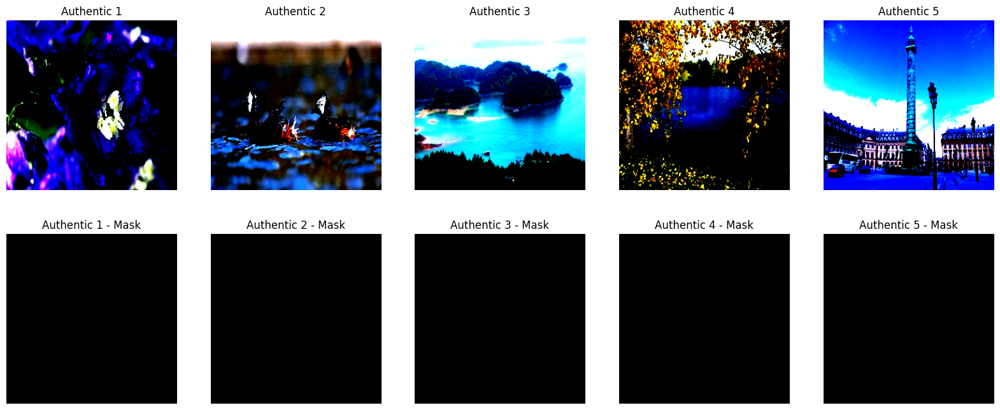

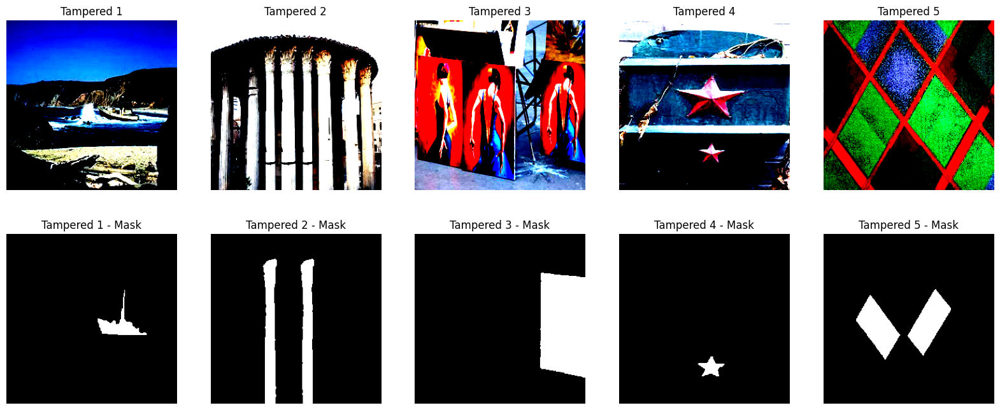

In [52]:
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import numpy as np

def plot_images_with_masks(images, masks, titles, rows=1, cols=5):
    fig, axes = plt.subplots(rows * 2, cols, figsize=(20, 8))
    for i, (img, mask, title) in enumerate(zip(images, masks, titles)):
        row_idx = i // cols
        col_idx = i % cols

        ax_img = axes[row_idx * 2, col_idx]
        ax_img.imshow(img.permute(1, 2, 0))
        ax_img.set_title(title)
        ax_img.axis('off')

        ax_mask = axes[row_idx * 2 + 1, col_idx]
        ax_mask.imshow(mask.squeeze(), cmap='gray')
        ax_mask.set_title(f"{title} - Mask")
        ax_mask.axis('off')
        
    plt.show()

authentic_images = []
authentic_masks = []
authentic_titles = []
count = 0
for idx in range(len(dataset)):
    img, mask = dataset[idx]
    if mask.sum() == 0: 
        authentic_images.append(img)
        authentic_masks.append(mask)
        authentic_titles.append(f"Authentic {count+1}")
        count += 1
    if count == 5:
        break

tampered_images = []
tampered_masks = []
tampered_titles = []
count = 0
for idx in range(len(dataset)):
    img, mask = dataset[idx]
    if mask.sum() > 0: 
        tampered_images.append(img)
        tampered_masks.append(mask)
        tampered_titles.append(f"Tampered {count+1}")
        count += 1
    if count == 5:
        break

plot_images_with_masks(authentic_images, authentic_masks, authentic_titles)

plot_images_with_masks(tampered_images, tampered_masks, tampered_titles)


In [ ]:
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

generator = torch.Generator().manual_seed(123)
train_dataset, val_dataset = random_split(dataset, [train_size, val_size], generator=generator)

In [5]:
dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = smp.Unet(
    encoder_name="resnet50",
    encoder_weights="imagenet", 
    in_channels=3,
    classes=1,
    activation="sigmoid"
).to(device)

model.load_state_dict(torch.load("/kaggle/input/unet_3/pytorch/default/1/unet_casia2 (3).pth", map_location=device))


config.json:   0%|          | 0.00/156 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

<ipython-input-5-94022d267597>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/kaggle/input/unet_3/pytorch/default/1/unet_casia2 (3).pth

<All keys matched successfully>

In [ ]:
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

def train_model(model, dataloader, device, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        running_loss = 0.0
        for images, masks, _ in dataloader:
            images, masks = images.to(device), masks.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, masks)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * images.size(0)
        epoch_loss = running_loss / len(dataloader.dataset)
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}")

train_model(model, dataloader, device, num_epochs=5)

In [6]:
def draw_mask_contours(image, binary_mask):
    print(image.shape)
    # image = (image * 255).astype(np.uint8)
    # if image.shape[2] == 3:
    # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # plt.imshow(image)
    mask = (binary_mask * 255).astype(np.uint8)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    circled_img = image.copy()

    for cnt in contours:
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        center = (int(x), int(y))
        radius = int(radius)
        if radius > 5:
            cv2.circle(circled_img, center, radius, (0, 0, 255), 2)

    return circled_img

(256, 256, 3)


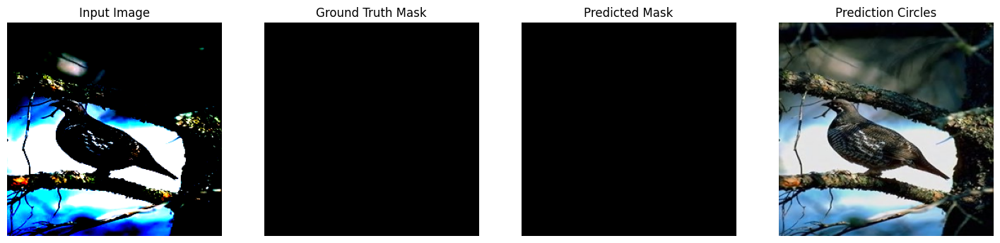

In [7]:
def show_prediction(model, image_tensor, ground_truth, sample_imgnp):
    model.eval()
    image_tensor = image_tensor.unsqueeze(0).to(device)
    with torch.no_grad():
        output = model(image_tensor)
        pred_mask = output.squeeze().cpu().numpy()
        pred_mask = (pred_mask>0.5).astype(int)
        # print(f"Max: {pred_mask.max()}, Min: {pred_mask.min()}")
        gt_mask = ground_truth.squeeze().numpy()
        circled_img = draw_mask_contours(sample_imgnp, pred_mask)
        
        plt.figure(figsize=(18, 4))
        plt.subplot(1, 4, 1)
        plt.imshow(image_tensor.squeeze().permute(1, 2, 0).cpu().numpy())
        plt.title("Input Image")
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(gt_mask, cmap='gray')
        plt.title("Ground Truth Mask")
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(pred_mask, cmap='gray')
        plt.title("Predicted Mask")
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(circled_img)
        plt.title("Prediction Circles")
        plt.axis('off')

        plt.show()

sample_image, sample_mask, sample_imgnp= val_dataset[1400]
show_prediction(model, sample_image, sample_mask,sample_imgnp)

(256, 256, 3)


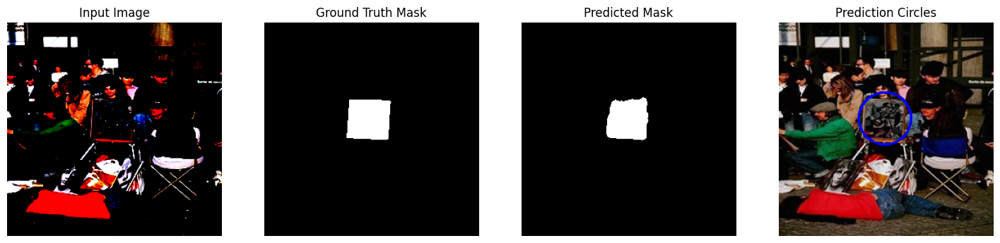

(256, 256, 3)


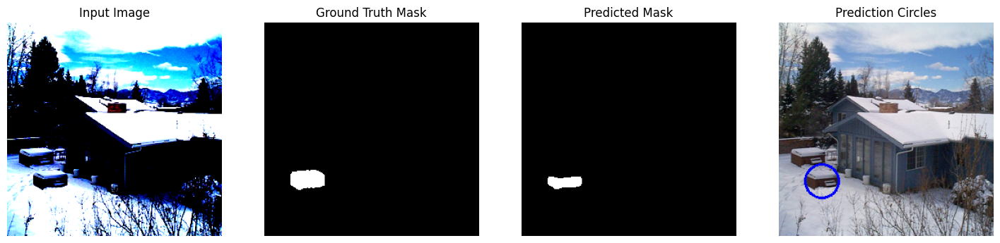

(256, 256, 3)


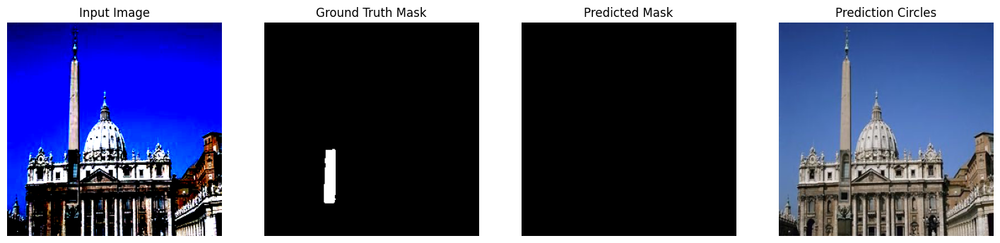

(256, 256, 3)


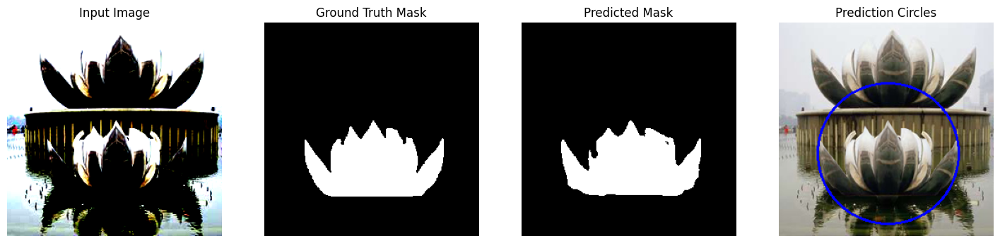

(256, 256, 3)


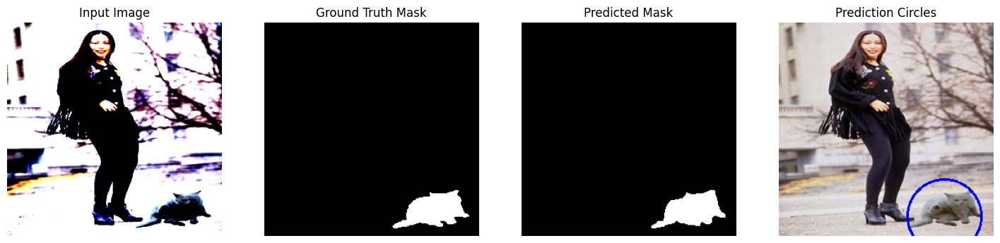

(256, 256, 3)


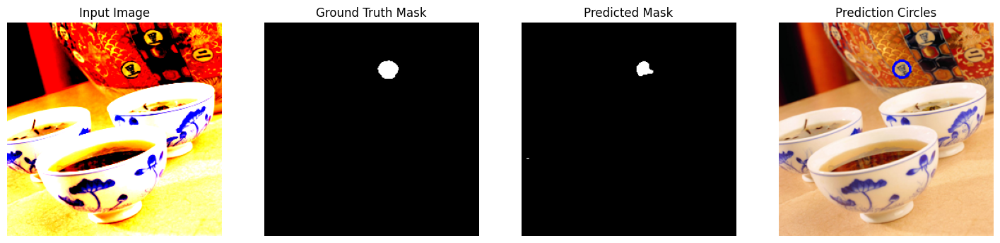

(256, 256, 3)


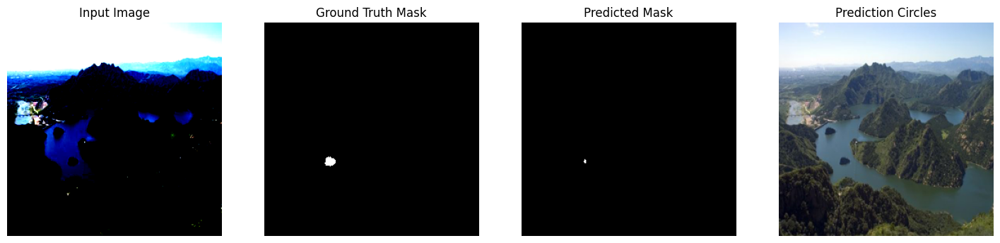

(256, 256, 3)


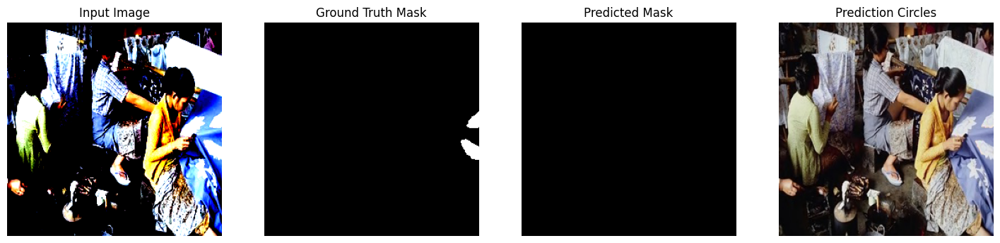

(256, 256, 3)


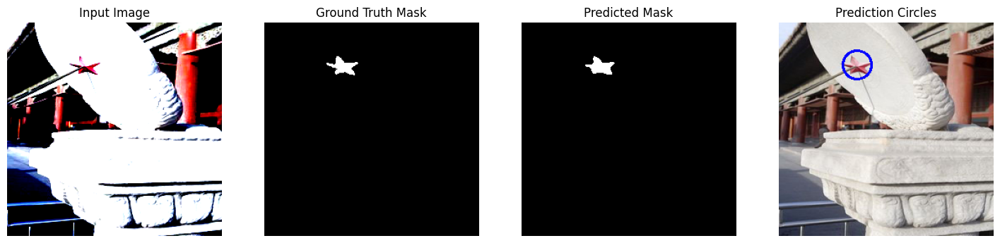

(256, 256, 3)


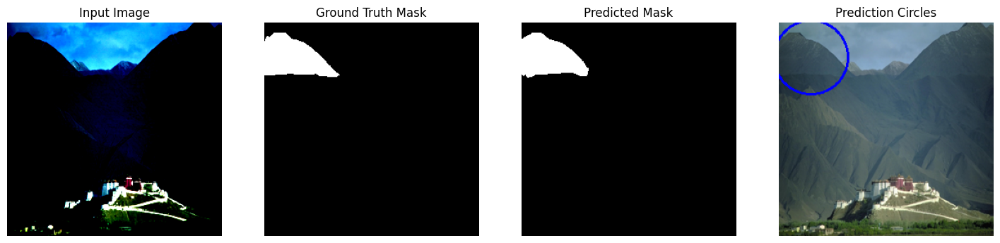

(256, 256, 3)


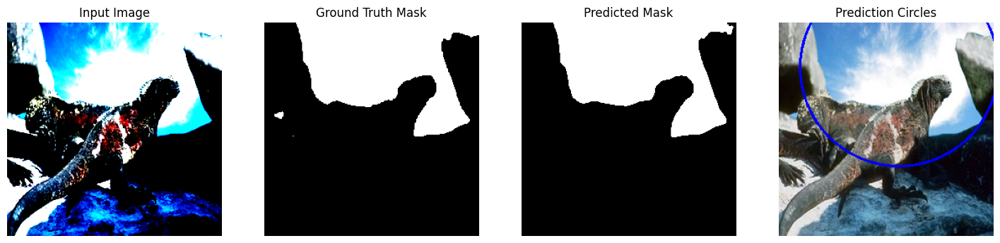

(256, 256, 3)


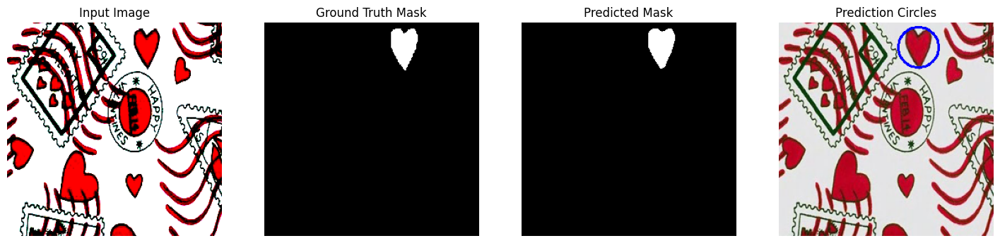

(256, 256, 3)


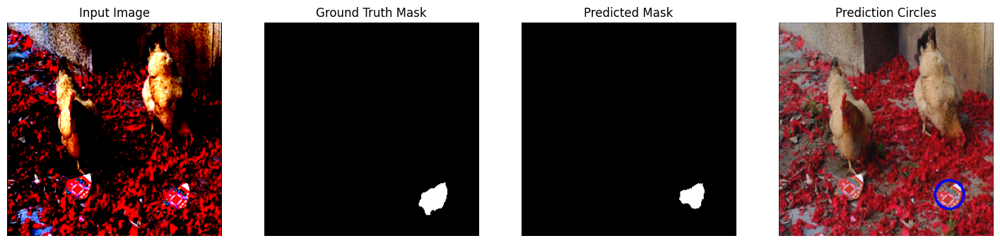

(256, 256, 3)


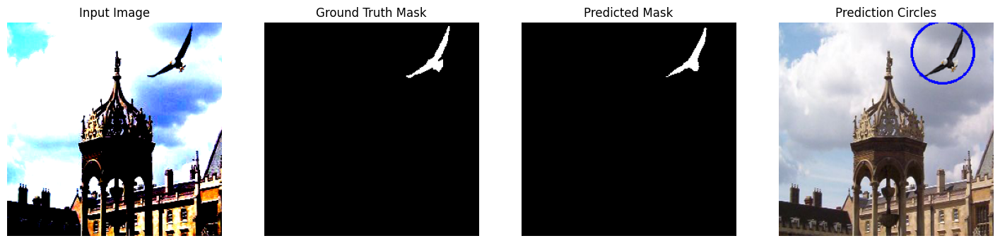

(256, 256, 3)


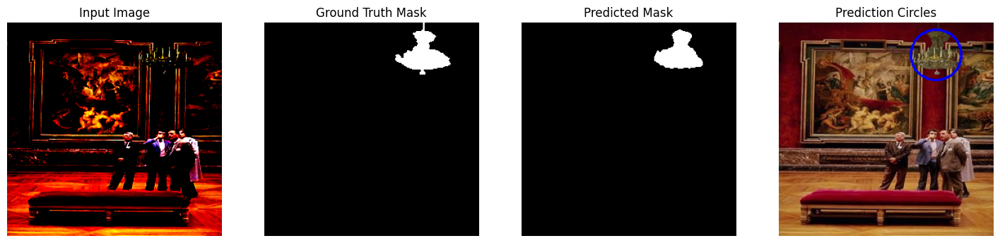

(256, 256, 3)


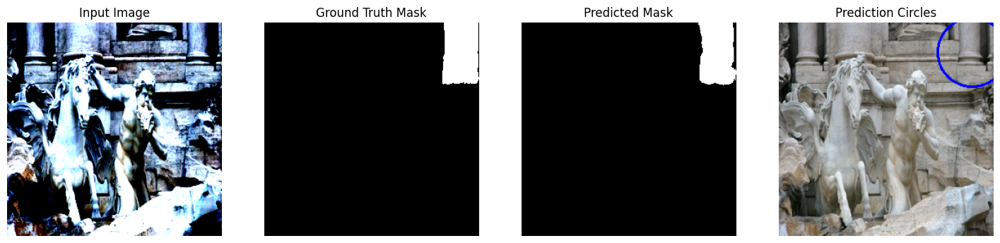

(256, 256, 3)


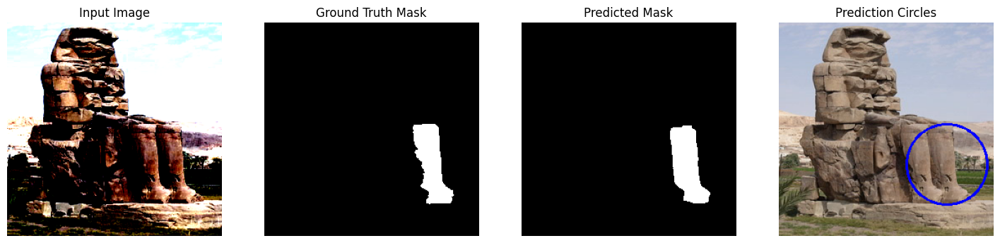

(256, 256, 3)


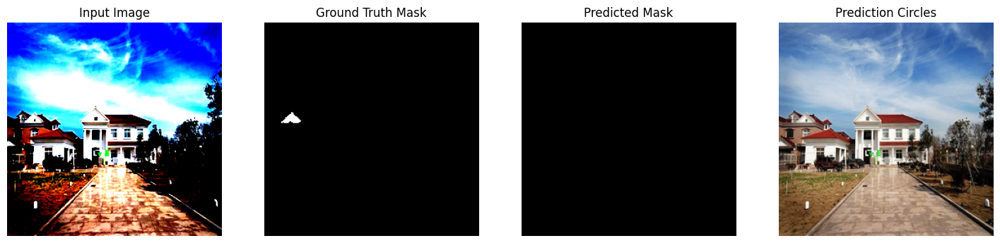

(256, 256, 3)


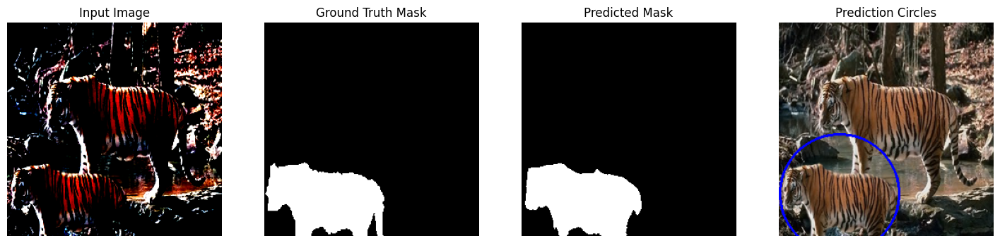

(256, 256, 3)


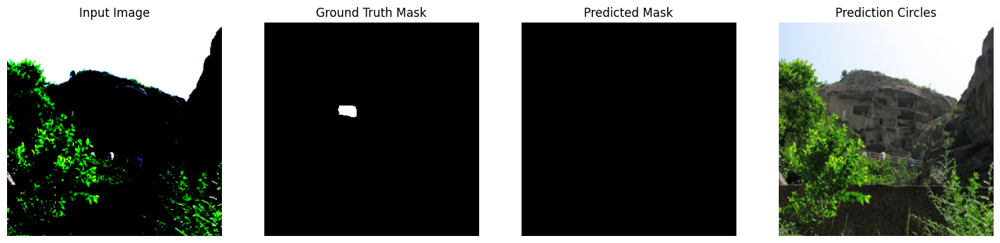

In [12]:
c=20
for images, masks, _ in val_dataset:
    if masks.sum()>0 and c>0:
        show_prediction(model, images, masks, _)
        c-=1
    if c==0: break

        

In [127]:
torch.save(model.state_dict(), "/kaggle/working/unet_casia2.pth")

In [8]:
def evaluate_metrics(preds, targets, threshold=0.15):
    # print(f"Type of preds: {type(preds)}, Type of targets: {type(targets)}")
    preds = (preds > threshold).float()
    targets = targets.float()
    preds_flat = preds.view(-1)
    targets_flat = targets.view(-1)
    # print(f"Type of preds: {type(preds)}, Type of targets: {type(targets)}")
    
    TP = (preds_flat * targets_flat).sum()
    FP = (preds_flat * (1 - targets_flat)).sum()
    FN = ((1 - preds_flat) * targets_flat).sum()
    TN = ((1 - preds_flat) * (1 - targets_flat)).sum()

    epsilon = 1e-7 

    accuracy = (TP + TN) / (TP + TN + FP + FN + epsilon)
    precision = TP / (TP + FP + epsilon)
    recall = TP / (TP + FN + epsilon)
    f1 = 2 * precision * recall / (precision + recall + epsilon)
    iou = TP / (TP + FP + FN + epsilon)
    dice = 2 * TP / (2 * TP + FP + FN + epsilon)

    return {
        'Accuracy': accuracy.item(),
        'Precision': precision.item(),
        'Recall': recall.item(),
        'F1 Score': f1.item(),
        'IoU': iou.item(),
        'Dice': dice.item()
    }


In [11]:
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=True)

model.eval()
with torch.no_grad():
    all_metrics = []

    for images, masks, _ in val_loader:
        images, masks = images.to(device), masks.to(device)
        outputs = model(images)
        
        metrics = evaluate_metrics(outputs, masks)
        all_metrics.append(metrics)

    avg_metrics = {k: sum(d[k] for d in all_metrics) / len(all_metrics) for k in all_metrics[0]}
    print("Validation Metrics:")
    for key, value in avg_metrics.items():
        print(f"{key}: {value:.4f}")


Validation Metrics:
Accuracy: 0.9927
Precision: 0.7870
Recall: 0.8613
F1 Score: 0.8089
IoU: 0.7269
Dice: 0.8089


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN

def channel1_with_mask(img,m,image_tensor):
    with torch.no_grad():
        output = model(image_tensor)
        pred_mask = output.squeeze().cpu().numpy()
        pred_mask = (pred_mask>0.5).astype(int)
        
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        m1 = m.squeeze().numpy()
        # Detect keypoints using GFTT
        gftt = cv2.GFTTDetector_create()
        keypoints = gftt.detect(gray, None)
        points = np.array([kp.pt for kp in keypoints], dtype=np.float32)
    
        # DBSCAN clustering
        db = DBSCAN(eps=10, min_samples=5).fit(points)
        labels = db.labels_
    
        mask = np.zeros(gray.shape, dtype=np.uint8)
    
        for i, point in enumerate(points):
            if labels[i] != -1:  
                x, y = map(int, point)
                mask[y, x] = 255
    
        kernel = np.ones((5, 5), np.uint8)
        mask = cv2.dilate(mask, kernel, iterations=1)
        
        # Visualize
        img_with_kps = img.copy()
        for i, point in enumerate(points):
            if labels[i] != -1:
                x, y = map(int, point)
                cv2.circle(img_with_kps, (x, y), 2, (255, 0, 0), -1)
    
        plt.figure(figsize=(18, 6))
        plt.subplot(1, 5, 1)
        plt.imshow(img)
        plt.title("Original Image")
        plt.axis('off')
    
        plt.subplot(1, 5, 2)
        plt.imshow(m1, cmap='gray')
        plt.title("Ground Truth")
        plt.axis('off')
    
        plt.subplot(1, 5, 3)
        plt.imshow(img_with_kps)
        plt.title("Image with Clustered Keypoints")
        plt.axis('off')
    
        plt.subplot(1, 5, 4)
        plt.imshow(pred_mask, cmap='gray')
        plt.title("U-net model output")
        plt.axis('off')
        
        plt.subplot(1, 5, 5)
        plt.imshow(mask, cmap='gray')
        plt.title("Binary Mask of Clusters")
        plt.axis('off')
    
        plt.tight_layout()
        plt.show()
    
        return mask


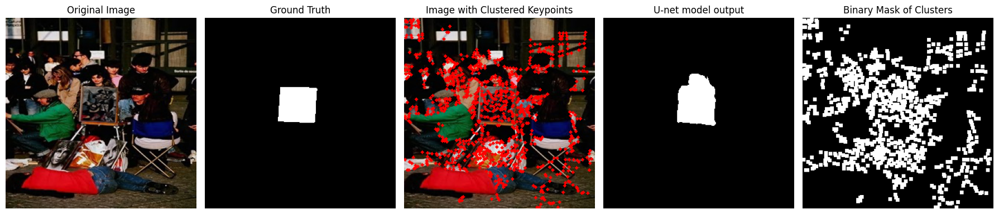

uint8


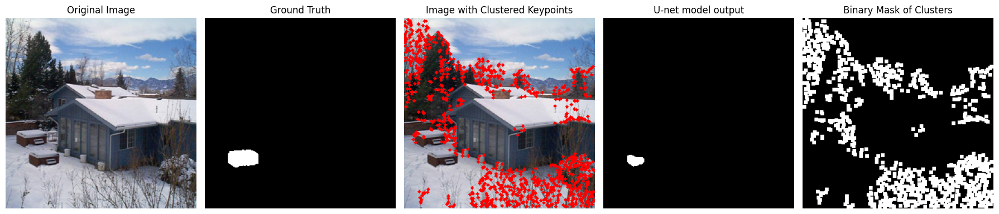

uint8


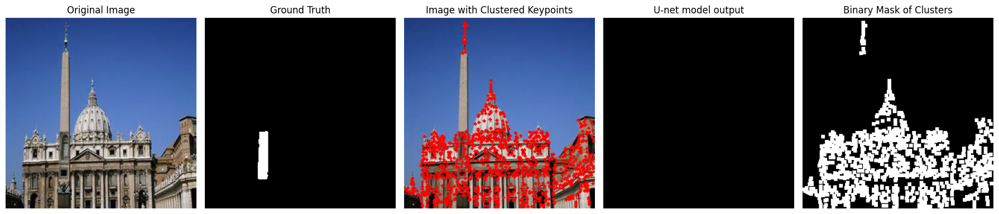

uint8


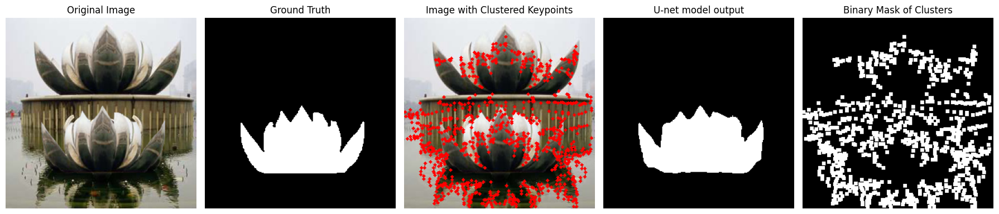

uint8


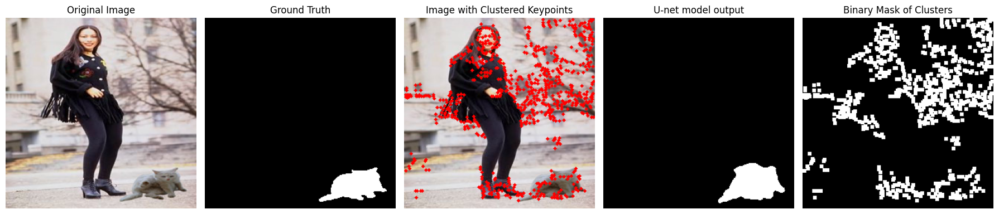

uint8


In [37]:
c = 5
for image_tensor, m, img in val_dataset:
    if m.sum() > 0 and c > 0:
        image_tensor = image_tensor.unsqueeze(0).to(device) 
        m1 = channel1_with_mask(img, m, image_tensor)           
        c -= 1
    if c == 0:
        break


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering

def detect_copy_move_censure_freak(image_np, mask_tensor, k=5, distance_thresh=25, cluster_dist_thresh=50):
    gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)

    # CenSurE (STAR)
    censure = cv2.xfeatures2d.StarDetector_create()
    keypoints = censure.detect(gray, None)

    if len(keypoints) < 2:
        return

    # FREAK descriptor
    freak = cv2.xfeatures2d.FREAK_create()
    keypoints, descriptors = freak.compute(gray, keypoints)

    if descriptors is None or len(descriptors) < 2:
        print("Descriptors couldn't be computed properly.")
        return

    # k-NN Matching
    bf = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches = bf.knnMatch(descriptors, descriptors, k=k)

    matched_points = []
    for m in matches:
        for n in m:
            if n.distance > 0 and n.distance < distance_thresh:
                p1 = keypoints[n.queryIdx].pt
                p2 = keypoints[n.trainIdx].pt
                if np.linalg.norm(np.array(p1) - np.array(p2)) > 5:
                    matched_points.append(p2)

    if len(matched_points) < 2:
        return

    matched_points = np.array(matched_points)

    # Clustering
    clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=cluster_dist_thresh, linkage='ward')
    labels = clustering.fit_predict(matched_points)

    image_with_circles = image_np.copy()
    colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)

    for label in np.unique(labels):
        cluster_points = matched_points[labels == label]
        for (x, y) in cluster_points:
            color = tuple(int(c * 255) for c in colors(label)[:3])
            cv2.circle(image_with_circles, (int(x), int(y)), radius=10, color=color, thickness=2)

    if mask_tensor.sum()>0:
        plt.figure(figsize=(14, 7))
    
        plt.subplot(1, 2, 1)
        plt.imshow(image_with_circles)
        plt.title("Forged Regions (Cluster Circles)")
        plt.axis('off')
    
        plt.subplot(1, 2, 2)
        plt.imshow(mask_tensor.squeeze(), cmap='gray')
        plt.title("Ground Truth Mask")
        plt.axis('off')
    
        plt.tight_layout()
        plt.show()


<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


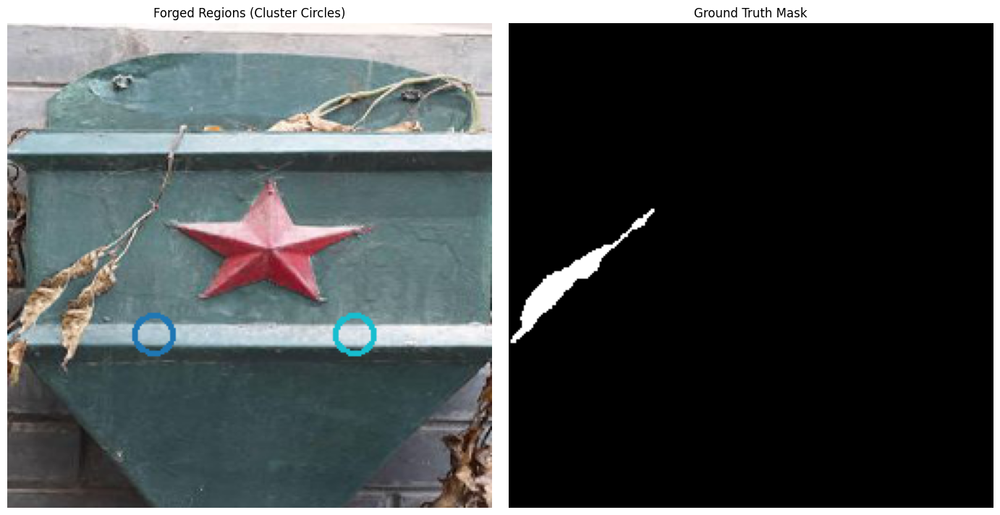

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


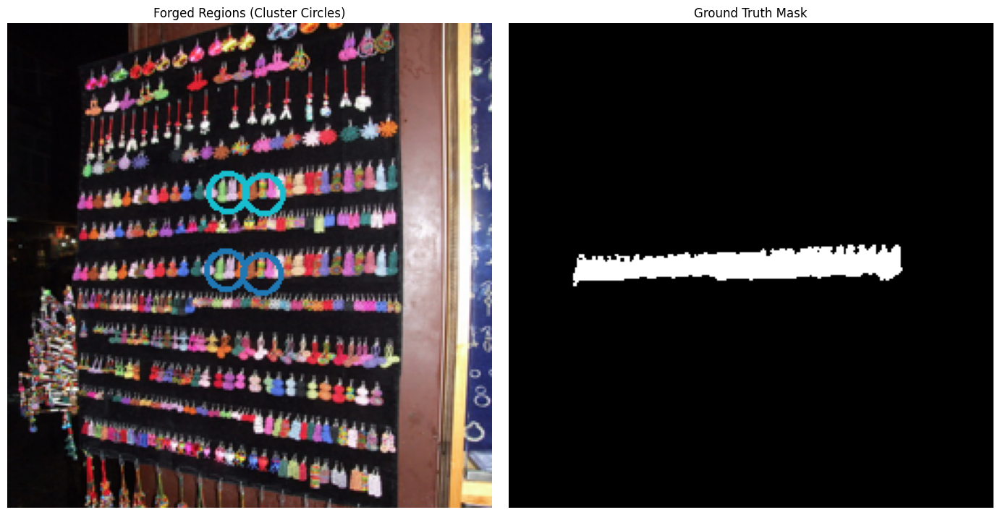

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


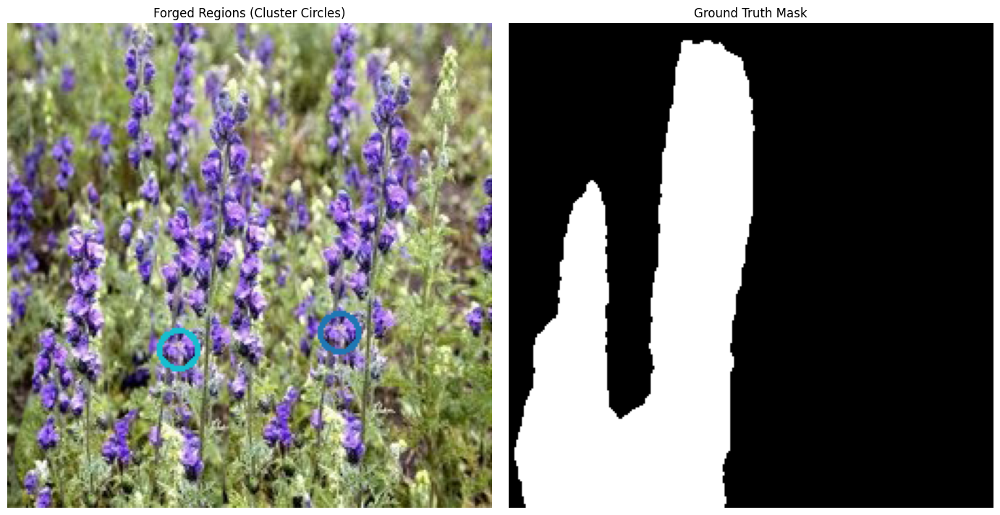

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


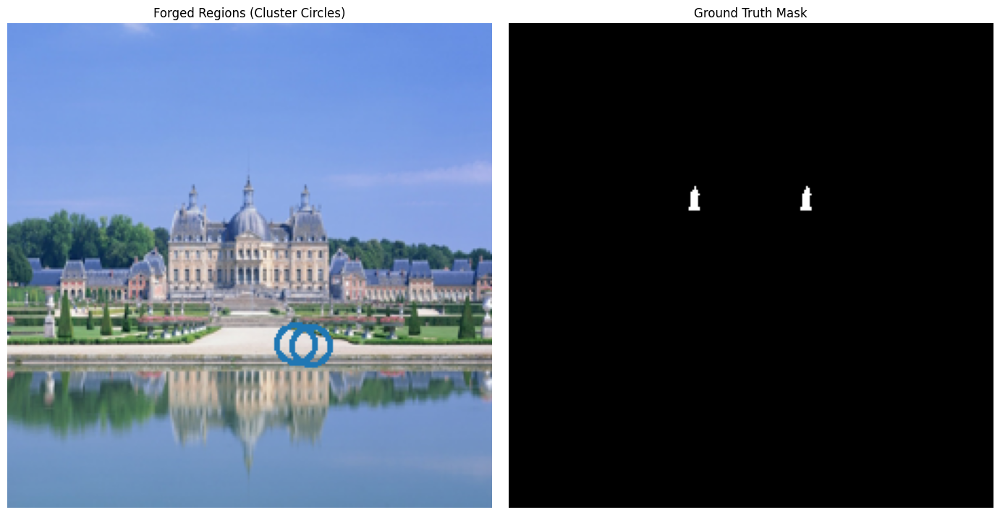

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


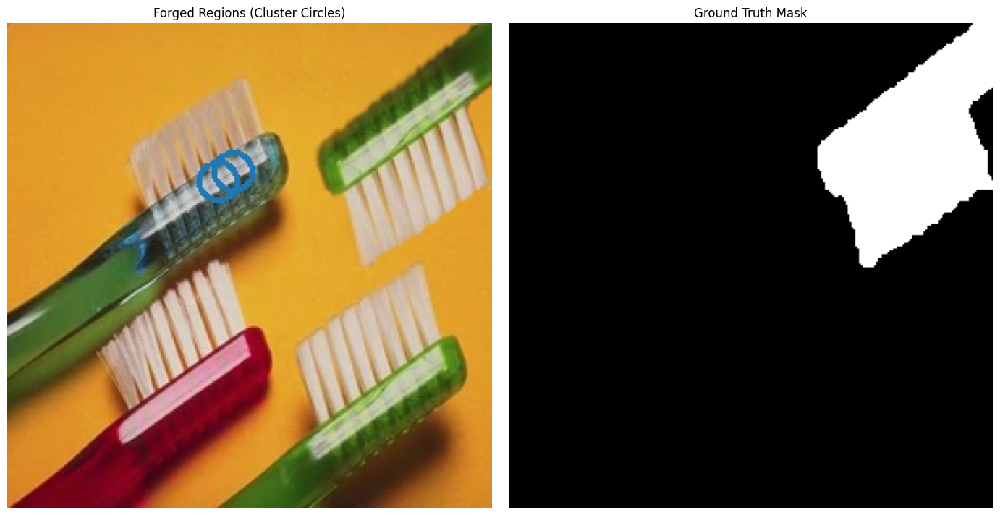

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


Descriptors couldn't be computed properly.


<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


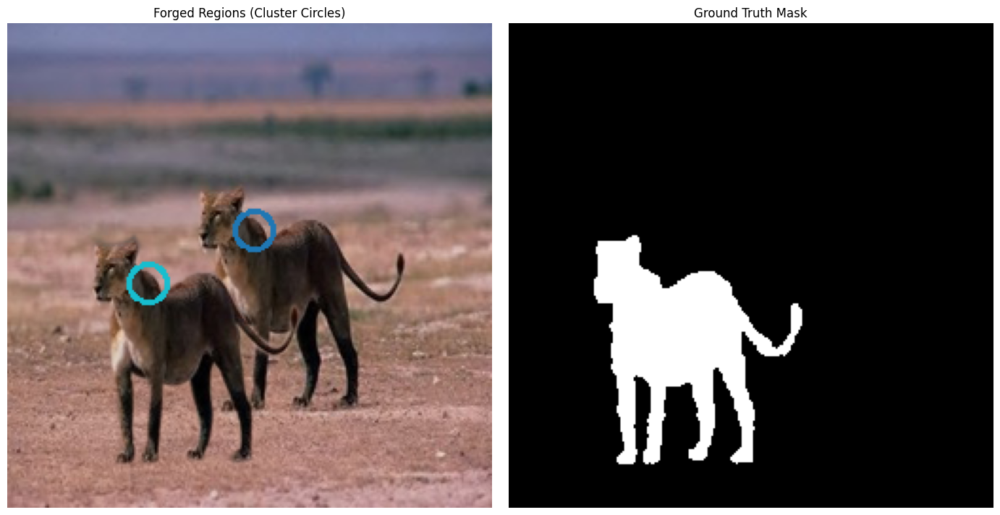

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


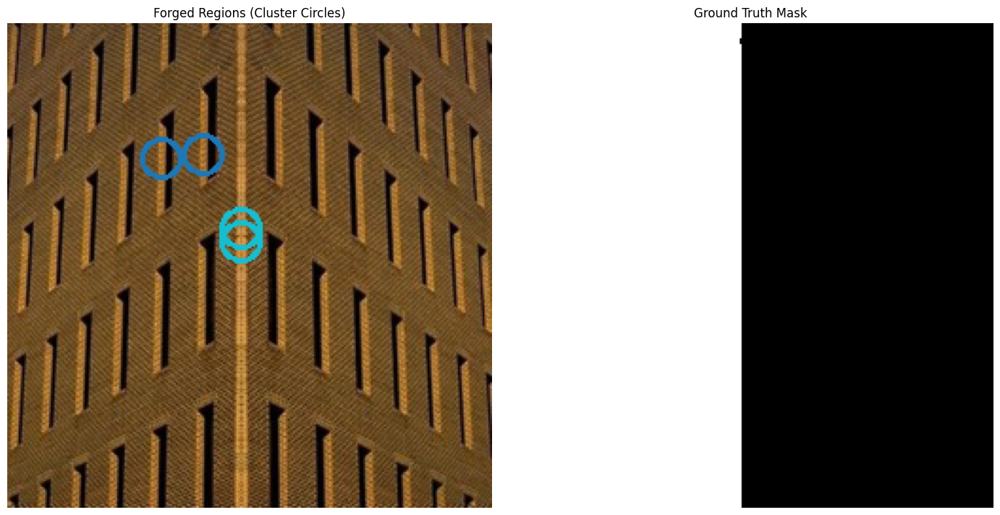

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


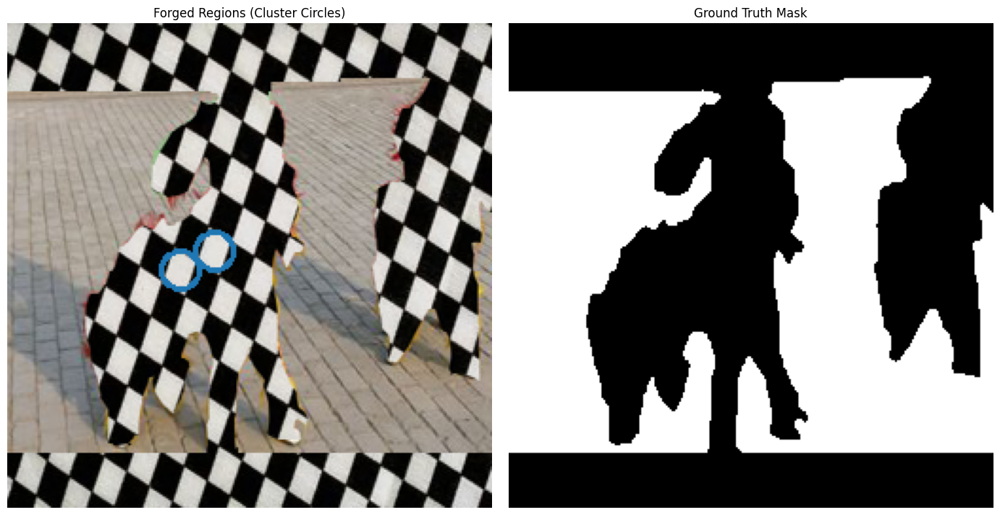

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


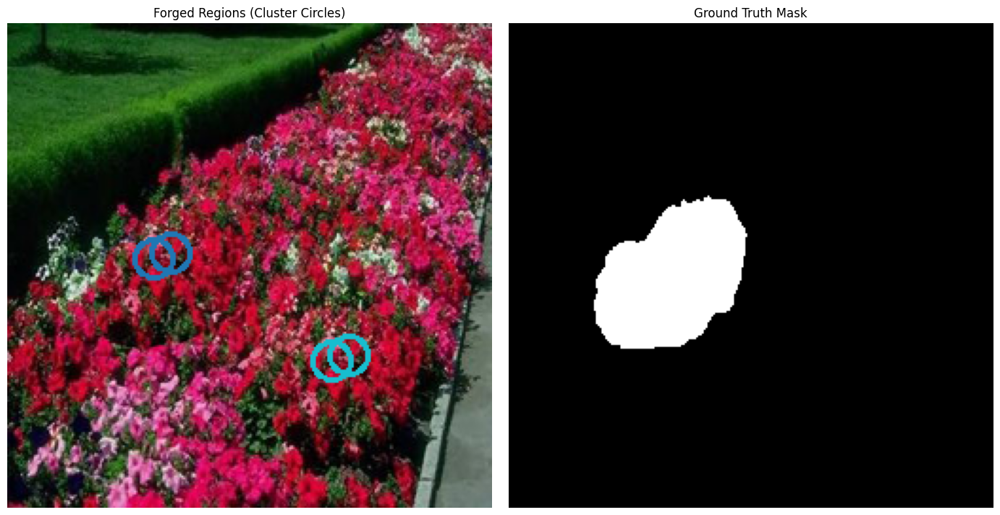

Descriptors couldn't be computed properly.


<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


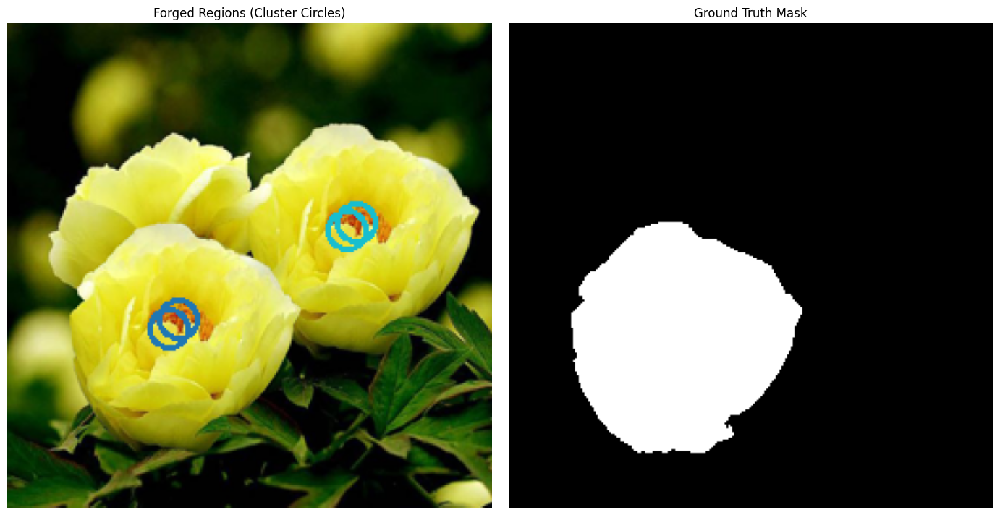

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


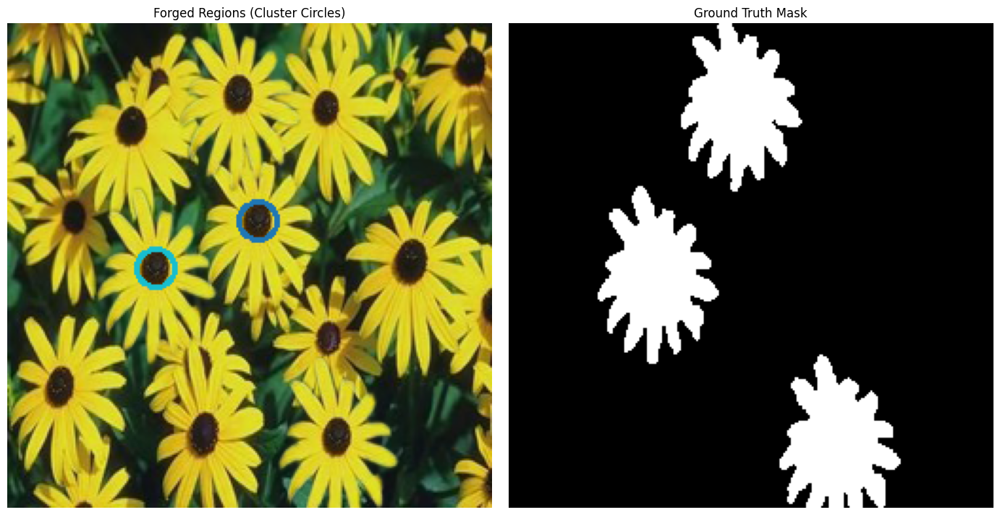

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


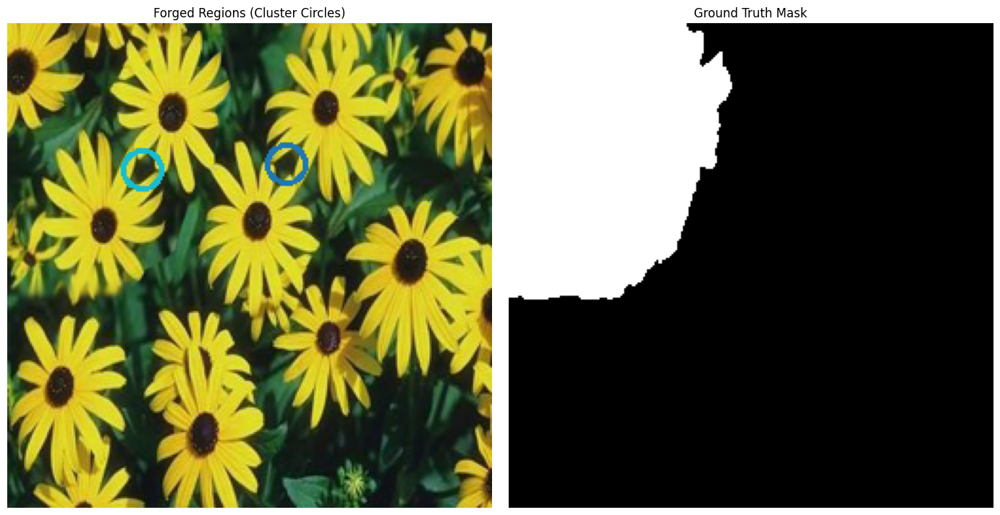

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


Descriptors couldn't be computed properly.
Descriptors couldn't be computed properly.


<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


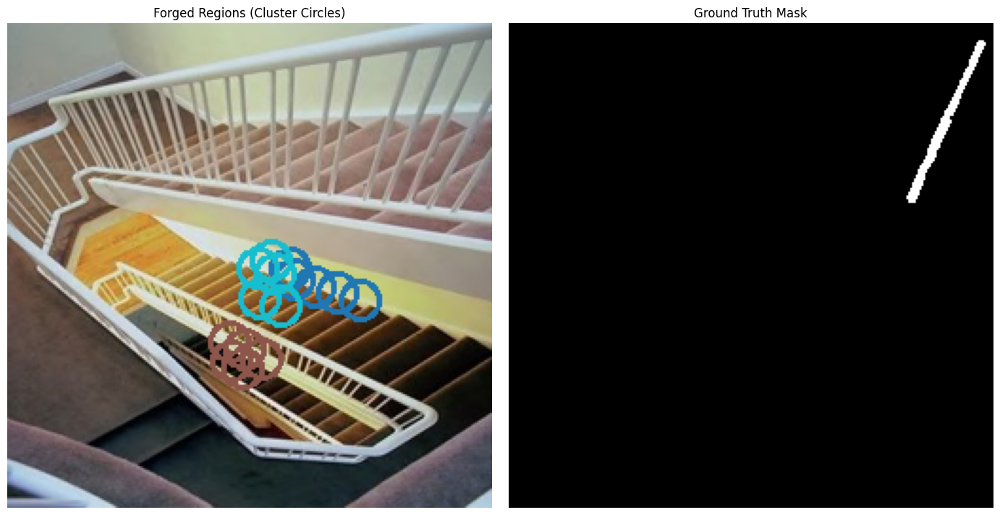

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


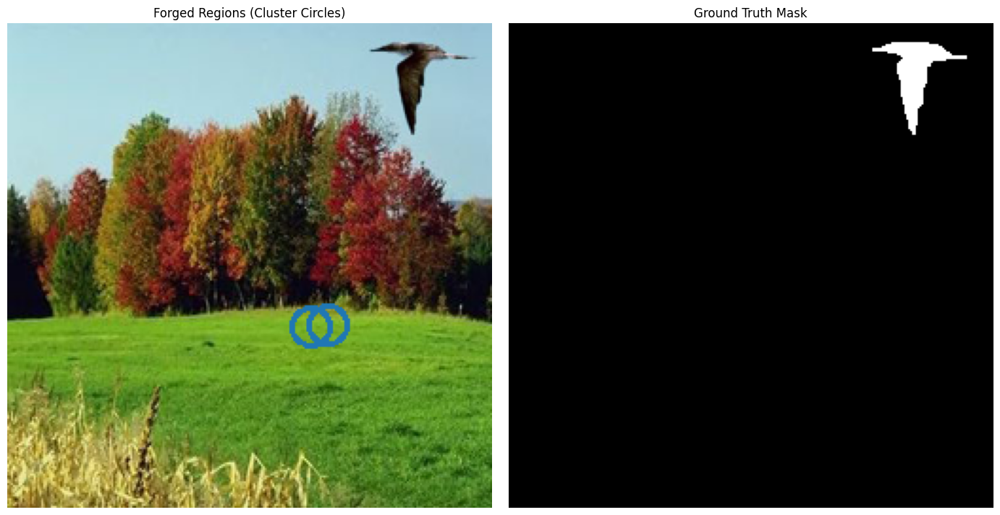

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


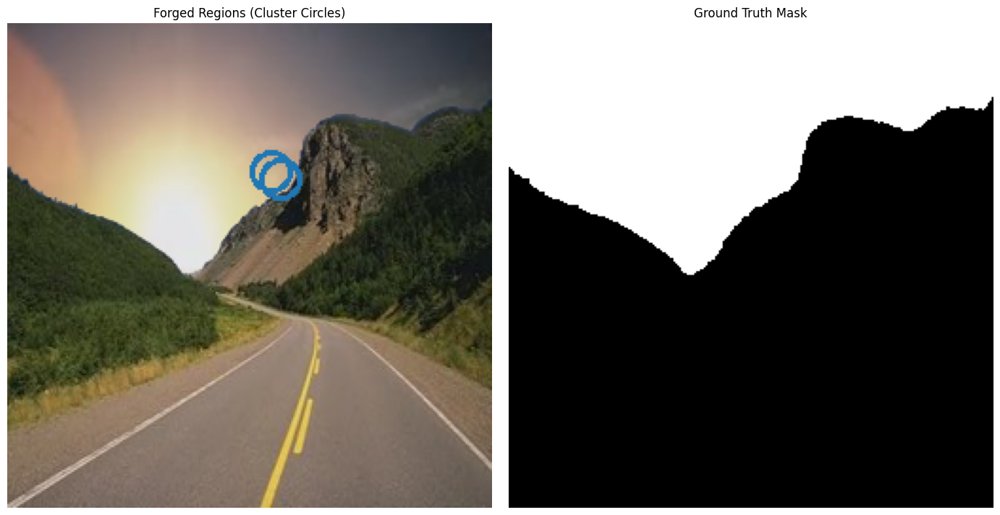

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


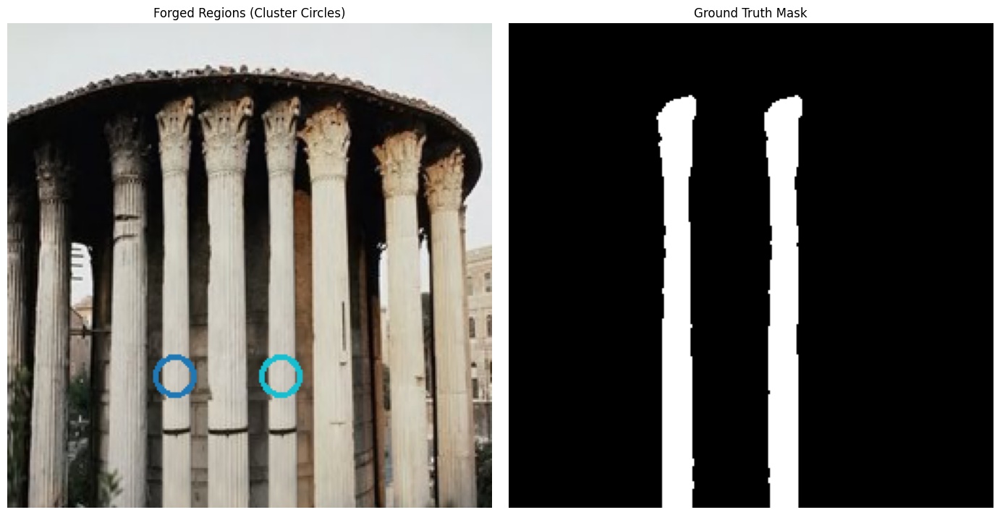

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


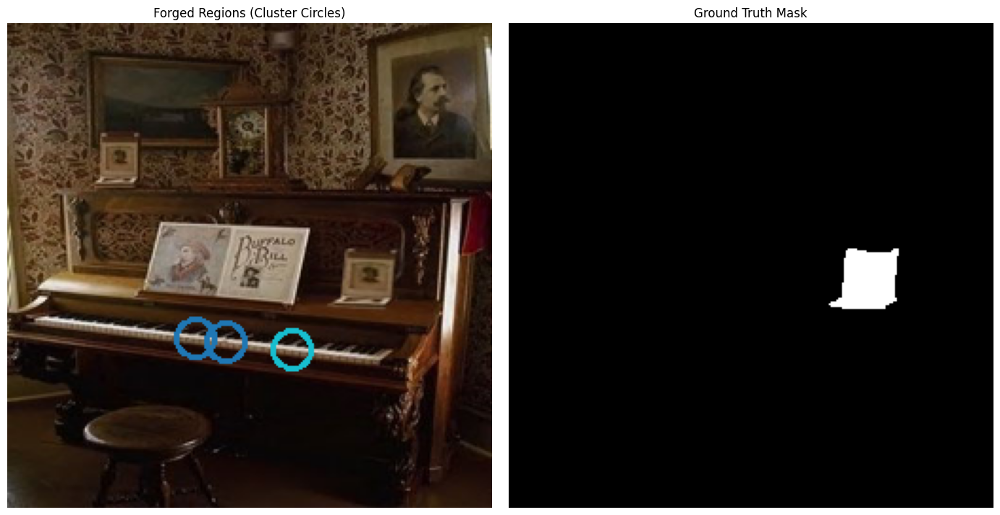

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


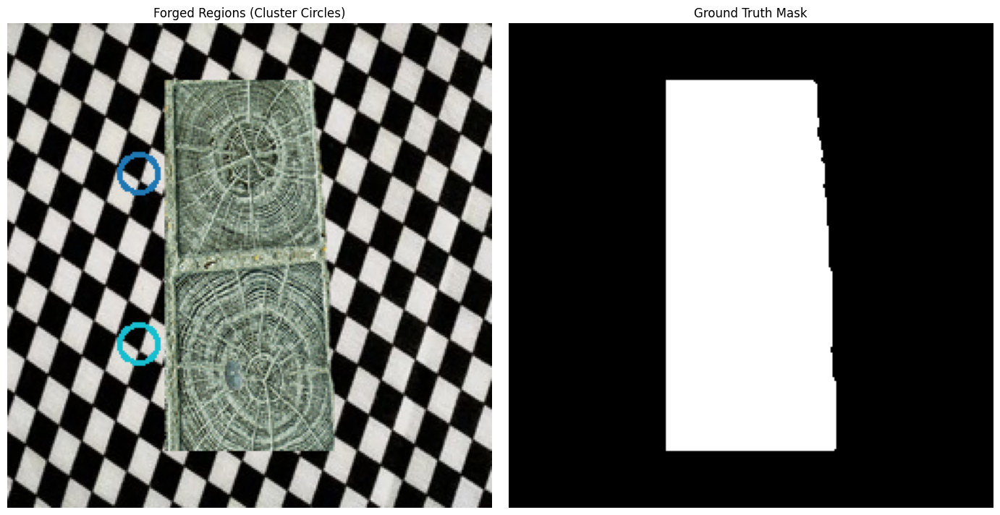

Descriptors couldn't be computed properly.
Descriptors couldn't be computed properly.


<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)
<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


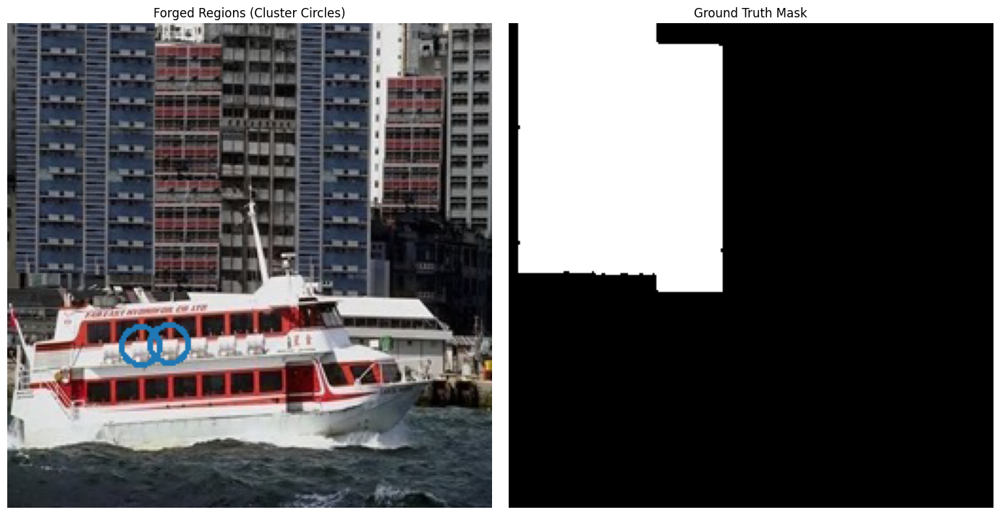

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


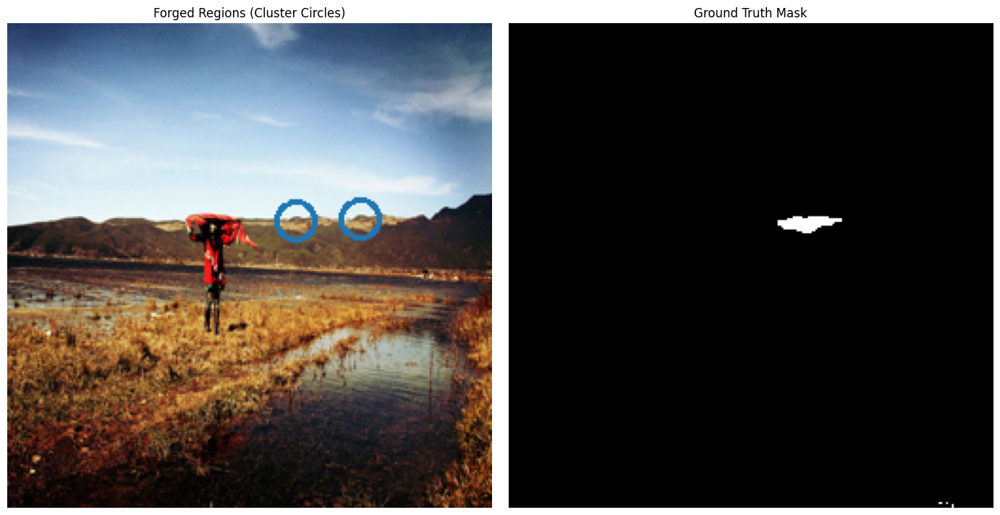

<ipython-input-25-ba7a350f55ac>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', np.max(labels) + 1)


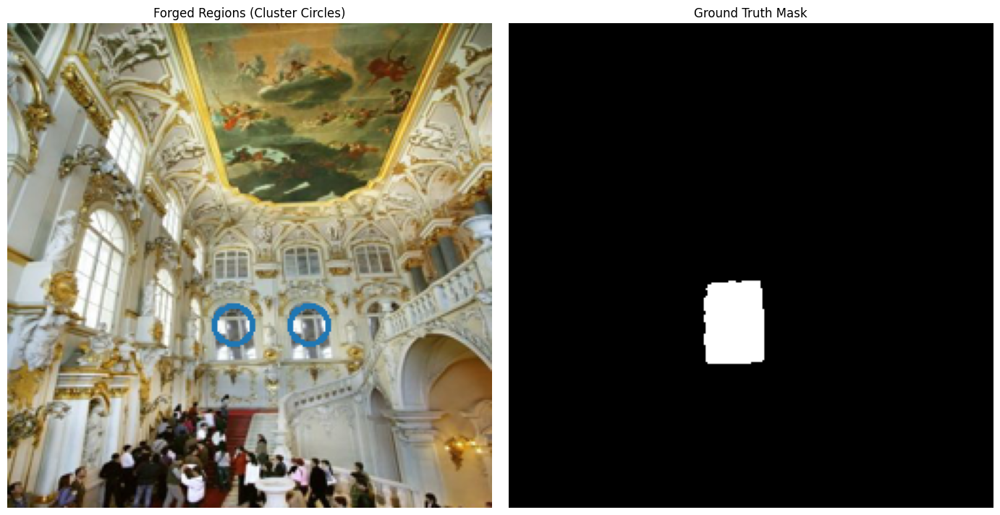

In [26]:
for it,m,i in val_dataset:
    m1 = m.squeeze().numpy()
    detect_copy_move_censure_freak(i,m1)